# Clustering de clientes

**Objetivo**:
- Obtener la cantidad K de clústers óptimo.
- Segregar a los clientes en K clústers.
- Plotear gráficos de los cluster para análisis de perfilamiento

<B>Especificaciones:</B> 
Se ralizan los siguientes pasos:
<ol>
<li> Selección de subset de variables para este este escenario </li>
<li> Analisis de outliers: eliminación de registros y/o imputación de valores tope</li>
<li> Análisis y selección de rango K óptimos (PCA y Elbow Method) </li>
<li> Ejecución de K-mean con rango de K óptimos y revisión coeficiente de silueta</li>
<li> Análisis de desempe con boxplot por cluster</li>
</ol>


<B>**Consideraciones**:</B>

- Las variables ingresadas al clustering fueron seleccionadas utilizando el ranking de un modelo analítico `Random Forest`, `Análisis Cualitativo` y`know-how` de negocio.</li>


**Variables utilizadas para el clustering**

|   VARIABLE	|   DESCRIPCIÓN	|
|---	|---	|
|  SHARE_OF_WALLET 	|   Ratio de saldo con Interconsumo sobre el saldo en el sistema financiero	|
|   CANTIDAD_ENTIDADES_CON_DEUDA	|   Cantidad de entidades únicas con las que el cliente tiene una deuda reportada en Buró	|
|   CUPO_TC_SF	|   Cupo o línea de crédito en tarjeta de crédito del sistema financiero	|
|   CANT_CREDITOS_VIGENTES_SF	|   Cantidad de créditos vigente del cliente reportado en Buró 	|
|   MONTO_DESEM_PRESTAMOS_IC_6MESES	|   Monto total desembolsado en  créditos de consumo en  Interconsumo	los últimos 6 meess|
|   SALDO_PREST_PRENDARIO_SF	|   Saldo del cliente en prestamos prendarios en el sistema financiero	|
|   SALDO_PREST_HIPOTECARIO_SF	|   Saldo del cliente en prestamos hipotecarios en el sistema financiero	|
|   MARGEN_ORDINAL_PROM_6MESES	|   Margen ordinal promedio que tiene el cliente en los últimos 6 meses	|
|   CANT_PRODUCTOS_ACTIVOS	|   Cantidad de productos activos del cliente con Interconsumo se cuenta incluso si tiene 2 productos del mismo tipo 	|
|   INGRESOS_QUETZALES	|   Ingresos declarados por el cliente en la moneda Quetzal	|
|   FLAG_USUARIO_DIGITAL	|   Flag que indica si el usuario es digital	|


## 1. Librerías

In [1]:
import time
tiempo_start = time.time()

In [2]:
import pandas as pd
import numpy as np
import os
import random


import gc

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import plotly.graph_objects as go
import plotly
import plotly.express as px
import plotly.io as pio

from ds_utils.unsupervised import plot_cluster_cardinality, plot_cluster_magnitude, plot_magnitude_vs_cardinality
from scipy.spatial.distance import euclidean
import warnings

warnings.filterwarnings('ignore')

In [3]:
from sklearn.cluster import KMeans # Modelo de K-Means
from sklearn.metrics import silhouette_score # Calculo de Silueta 
from sklearn.metrics import * # Davies bouldin 
from sklearn.decomposition import PCA #Análisis PCA
from sklearn.preprocessing import MinMaxScaler # Escalar data 

pd.options.display.max_columns  = 100
pd.options.display.max_rows = 1000
pd.options.display.float_format = lambda x: '{:,.3f}'.format(x) if x > 1e3 else '{:,.3f}'.format(x)
plotly.offline.init_notebook_mode() # Visualizar los gráficos de plotly al exportar en HTML


In [4]:
# Seteamos parámetros para archivos input
ruta_maestra = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\2. Selección de Variables Cuantitativo\BD_SELECCION_VARIABLES_2023.03.31.csv'


In [6]:
# Seteamos parámetros para archivos output

# Usamos la funcion para guardar las imagenes de los box plot
directory_box_inicial = 'outputs/Gráficas/k6_Box_plots'
ruta_output_k6 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k6_clusters_28.04.2023.csv'
ruta_descriptivos_k6 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k6_descriptivos_cluster_28.04.2023.xlsx'

ruta_output_k5 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k5_clusters_28.04.2023.csv'
ruta_descriptivos_k5 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k5_descriptivos_cluster_28.04.2023.xlsx'

ruta_output_k4 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k4_clusters_28.04.2023.csv'
ruta_descriptivos_k4 = r'C:\Users\PS342TS\OneDrive - EY\Interconsumo\Clustering\3. Clustering\outputs\Clusters\Escenario Final\k4_descriptivos_cluster_28.04.2023.xlsx'


## 2. Lectura Bases

**Lectura de `base master`**

In [7]:
# Leemos la Tabla Maestra

dtype_maestra = {'IdCliente': str,
'SALDO_TOTAL_SF': np.float32,
'SHARE_OF_WALLET': np.float32,
'CANTIDAD_ENTIDADES_CON_DEUDA': np.int32,
'CUPO_TC_SF': np.float32,
'CANT_CREDITOS_VIGENTES_SF': np.float32,
'MONTO_DESEMB_TOTAL_SF_ULT6M': np.float32,
'SALDO_PREST_PRENDARIO_SF': np.float32,
'SALDO_PREST_HIPOTECARIO_SF': np.float32,
'SALDO_PREST_FIDUCIARIO_SF': np.float32,
'SHARE_OF_WALLET_FIDUCIARIO': np.float32,
'SALDO_PREST_FIDUC_COMPETIDORES': np.float32,
'CANT_DESEMBOLSOS_IC_6MESES': np.float32,
'MONTO_DESEM_PRESTAMOS_IC_6MESES': np.float32,
'CANT_DESEMB_IC_6MESES': np.float32,
'SALDO_SUM_IC_6MESES': np.float32,
'SALDO_PROM_IC_6MESES': np.float32,
'MARGEN_ORDINAL_PROM_6MESES': np.float32,
'CANT_TIPO_PRODUCTOS_ACTIVOS': np.float32,
'CANT_PRODUCTOS_ACTIVOS': np.float32,
'TIEMPO_LABORANDO_MESES': np.float32,
'EDAD_ANIOS': np.float32,
'INGRESOS_QUETZALES': np.float32,
'ANTIGUEDAD_IC_CORTE': np.float32,
'FLAG_USUARIO_DIGITAL': np.int32
}

df_maestra = pd.read_csv(ruta_maestra, dtype=dtype_maestra, parse_dates=[1,16,19,22], sep=";")

# Visualizamos las primeras filas
df_maestra.head()

,IdCliente,fechaSaldos,SALDO_TOTAL_SF,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEMB_TOTAL_SF_ULT6M,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,SALDO_PREST_FIDUCIARIO_SF,SHARE_OF_WALLET_FIDUCIARIO,SALDO_PREST_FIDUC_COMPETIDORES,Periodo,CANT_DESEMBOLSOS_IC_6MESES,MONTO_DESEM_PRESTAMOS_IC_6MESES,Periodo_Fecha_x,CANT_DESEMB_IC_6MESES,SALDO_SUM_IC_6MESES,Fecha,SALDO_PROM_IC_6MESES,MARGEN_ORDINAL_PROM_6MESES,Periodo_Fecha_y,CANT_TIPO_PRODUCTOS_ACTIVOS,CANT_PRODUCTOS_ACTIVOS,TIEMPO_LABORANDO_MESES,EDAD_ANIOS,INGRESOS_QUETZALES,ANTIGUEDAD_IC_CORTE,FLAG_USUARIO_DIGITAL
0,10000,2022-04-30,"71,825.812",0.000,3,"59,244.309",2.000,"4,000.000",0.000,0.000,"29,134.410",0.000,0.000,0.000,0.000,0.000,0,0.000,0.000,0,0.000,0.000,0,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
1,10000,2022-05-31,"75,545.344",0.000,3,"59,244.309",2.000,"4,000.000",0.000,0.000,"28,631.430",0.000,0.000,0.000,0.000,0.000,0,0.000,0.000,0,0.000,0.000,0,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
2,10000,2022-06-30,"85,612.273",0.000,4,"101,969.242",3.000,"8,000.000",0.000,0.000,"32,120.900",0.000,0.000,0.000,0.000,0.000,0,0.000,0.000,0,0.000,0.000,0,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
3,10000,2022-07-31,"98,462.570",0.000,4,"101,969.242",3.000,"8,000.000",0.000,0.000,"31,316.340",0.000,0.000,0.000,0.000,0.000,0,0.000,0.000,0,0.000,0.000,0,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
4,10000,2022-08-31,"131,537.641",0.000,4,"101,969.242",3.000,"4,000.000",0.000,0.000,"31,316.340",0.000,0.000,0.000,0.000,0.000,0,0.000,0.000,0,0.000,0.000,0,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0


In [8]:
# Obtenemos la Base de Clientes única
df_maestra.columns

Index(['IdCliente', 'fechaSaldos', 'SALDO_TOTAL_SF', 'SHARE_OF_WALLET',
       'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEMB_TOTAL_SF_ULT6M',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'SALDO_PREST_FIDUCIARIO_SF', 'SHARE_OF_WALLET_FIDUCIARIO',
       'SALDO_PREST_FIDUC_COMPETIDORES', 'Periodo',
       'CANT_DESEMBOLSOS_IC_6MESES', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
       'Periodo_Fecha_x', 'CANT_DESEMB_IC_6MESES', 'SALDO_SUM_IC_6MESES',
       'Fecha', 'SALDO_PROM_IC_6MESES', 'MARGEN_ORDINAL_PROM_6MESES',
       'Periodo_Fecha_y', 'CANT_TIPO_PRODUCTOS_ACTIVOS',
       'CANT_PRODUCTOS_ACTIVOS', 'TIEMPO_LABORANDO_MESES', 'EDAD_ANIOS',
       'INGRESOS_QUETZALES', 'ANTIGUEDAD_IC_CORTE', 'FLAG_USUARIO_DIGITAL'],
      dtype='object')

In [9]:
# Revisamos la cantidad de periodos en la data
df_maestra.fechaSaldos.unique()

array(['2022-04-30T00:00:00.000000000', '2022-05-31T00:00:00.000000000',
       '2022-06-30T00:00:00.000000000', '2022-07-31T00:00:00.000000000',
       '2022-08-31T00:00:00.000000000', '2022-10-31T00:00:00.000000000',
       '2022-11-30T00:00:00.000000000', '2022-12-31T00:00:00.000000000',
       '2022-09-30T00:00:00.000000000', '2023-01-31T00:00:00.000000000'],
      dtype='datetime64[ns]')

In [10]:
# Visualizamos la cantidad de clientes
df_maestra[['IdCliente','fechaSaldos']].groupby(['fechaSaldos'], as_index= False).nunique()

,fechaSaldos,IdCliente
0,2022-04-30,71098
1,2022-05-31,91924
2,2022-06-30,63891
3,2022-07-31,96979
4,2022-08-31,96582
5,2022-09-30,84739
6,2022-10-31,106060
7,2022-11-30,108348
8,2022-12-31,113845
9,2023-01-31,91495


In [11]:
# Obtenemos clientes únicos
df_clientes = df_maestra.drop_duplicates(['IdCliente']).copy()
df_clientes.IdCliente.nunique()

113845

In [12]:
# Listado de todas las variables potenciales del ranking de variables
cols_poteniales = ['IdCliente',
  'SALDO_TOTAL_SF', 'SHARE_OF_WALLET',
       'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEMB_TOTAL_SF_ULT6M',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'SALDO_PREST_FIDUCIARIO_SF', 'SHARE_OF_WALLET_FIDUCIARIO',
       'SALDO_PREST_FIDUC_COMPETIDORES', 
       'CANT_DESEMBOLSOS_IC_6MESES', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
        'CANT_DESEMB_IC_6MESES', 'SALDO_SUM_IC_6MESES',
        'SALDO_PROM_IC_6MESES', 'MARGEN_ORDINAL_PROM_6MESES',
        'CANT_TIPO_PRODUCTOS_ACTIVOS',
       'CANT_PRODUCTOS_ACTIVOS', 'TIEMPO_LABORANDO_MESES', 'EDAD_ANIOS',
       'INGRESOS_QUETZALES', 'ANTIGUEDAD_IC_CORTE', 'FLAG_USUARIO_DIGITAL'
]

In [13]:
# Listado de variables que se incluirán en el cluster de este escenario
cols_cluster = [
'SHARE_OF_WALLET',
'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
'MARGEN_ORDINAL_PROM_6MESES',
'CANT_PRODUCTOS_ACTIVOS',
'INGRESOS_QUETZALES',  'FLAG_USUARIO_DIGITAL'
]

In [14]:
# Obtenemos la cantidad de variables que se incluirán en el clustering
len(cols_cluster)

11

## 3. Análisis de campos principales

In [15]:
# Fitlramos de la base master las columnas potenciales para el cluster
df_cluster = df_clientes[cols_poteniales]
print('Filas:', df_cluster.shape[0], 'Columnas:', df_cluster.shape[1])
df_cluster.head(2)

Filas: 113845 Columnas: 25


,IdCliente,SALDO_TOTAL_SF,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEMB_TOTAL_SF_ULT6M,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,SALDO_PREST_FIDUCIARIO_SF,SHARE_OF_WALLET_FIDUCIARIO,SALDO_PREST_FIDUC_COMPETIDORES,CANT_DESEMBOLSOS_IC_6MESES,MONTO_DESEM_PRESTAMOS_IC_6MESES,CANT_DESEMB_IC_6MESES,SALDO_SUM_IC_6MESES,SALDO_PROM_IC_6MESES,MARGEN_ORDINAL_PROM_6MESES,CANT_TIPO_PRODUCTOS_ACTIVOS,CANT_PRODUCTOS_ACTIVOS,TIEMPO_LABORANDO_MESES,EDAD_ANIOS,INGRESOS_QUETZALES,ANTIGUEDAD_IC_CORTE,FLAG_USUARIO_DIGITAL
0,10000,"71,825.812",0.000,3,"59,244.309",2.000,"4,000.000",0.000,0.000,"29,134.410",0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
8,100000,"9,888.480",0.000,2,"3,200.000",2.000,"10,601.330",0.000,0.000,"9,888.480",0.000,0.000,0.000,0.000,2.000,"1,099.090",183.182,7.801,0.000,0.000,7.000,22.000,"3,450.500",289.000,0


Extraemos los principales estadísticos para las variables potenciales seleccionadas

In [16]:
# Creamos funcion para describir los valores incluyendo nulos y ceros
def describe_nan(df, list_names=None, types='ALL'):
    if list_names==None:
        if types=='ALL':
            df_temp = df.copy()
        if types=='NUM':
            df_temp = df.select_dtypes(include=[np.number]).copy()
        if types=='OBJ':
            df_temp = df.select_dtypes(include=[object]).copy()
    else:
        df_temp = df[list_names].copy()
    count_nan = df_temp.isnull().sum(axis=0)
    total_row = df_temp.apply(lambda x: len(x))
    nan_porcen = (df_temp.apply(lambda x: x.isnull().sum(axis=0))/total_row*100).round(0).astype(str)
    count_ceros = df_temp[df_temp==0].count(axis=0)
    ceros_porcen = (df_temp.apply(lambda x: x[x==0].count())/total_row*100).round(0).astype(str)
    df_describe = df_temp.describe().append(pd.Series(count_nan, name='Count_NaN'))
    df_describe = df_describe.append(pd.Series(nan_porcen, name='Porcen_NaN'))
    df_describe = df_describe.append(pd.Series(count_ceros, name='Count_Ceros'))
    df_describe = df_describe.append(pd.Series(ceros_porcen, name='Porcen_Ceros'))
    df_describe = df_describe.append(pd.Series(total_row, name='Total_Row'))
    return df_describe

In [17]:
# Listamos las variables numericas de clustering
list_names_vars = cols_cluster
print('Cantidad de variables numericas:', len(list_names_vars))

Cantidad de variables numericas: 11


In [18]:
# Extraemos los principales estadísticos para las variables numéricas 
print('Columnas:', describe_nan(df_cluster, list_names=list_names_vars).shape[1])
describe_nan(df_cluster, list_names=list_names_vars)

Columnas: 11


,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL
count,"113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000","113,845.000"
mean,0.328,1.904,"13,939.850",1.778,264.919,"1,117.666","5,746.333",21.692,0.432,"4,780.381",0.564
std,0.438,1.200,"40,744.973",1.835,"1,522.121","13,333.950","93,643.867",39.919,0.556,"3,400.020",0.496
min,0.000,1.000,0.000,0.000,0.000,0.000,0.000,-186.384,0.000,"1,000.000",0.000
25%,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,"3,128.000",0.000
50%,0.000,2.000,"3,075.920",2.000,0.000,0.000,0.000,0.000,0.000,"4,000.000",1.000
75%,1.000,2.000,"11,281.010",2.000,0.000,0.000,0.000,31.095,1.000,"5,000.000",1.000
max,1.000,12.000,"1,244,241.875",92.000,"50,000.000","918,362.000","21,179,256.000","1,855.000",3.000,"50,000.000",1.000
Count_NaN,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
Porcen_NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Graficamos los boxplots de todas las variables**<br>
Se guardan los boxplots en imágenes en la carpeta que se especifica. 

In [19]:
# Funcion para guardar el box plot de cada variable numerica
def save_box_plot(df, list_vars, directory):
    fig = plt.figure(figsize =(15, 10))
    fig.patch.set_facecolor('#FFFFFF')
    sns.set_context("notebook")

    # Guarda las imagenes de box plot
    num_names = len(list_vars)
    for i in range(num_names):
        if not os.path.exists(directory):
            os.makedirs(directory)
        sns_plot = sns.boxplot(x=df[list_vars[i]])
        sns_plot.xaxis.labelpad = 20
        sns_plot.figure.savefig(f'{directory}\\{i+1}_{list_vars[i]}.png')
        plt.clf()

In [20]:
# Descomentar la línea inferior para usar la función 
save_box_plot(df_cluster[cols_cluster], list_names_vars, directory_box_inicial)

<Figure size 1080x720 with 0 Axes>

**Análisis de outliers**<br>
Analizamos las variables, calculando sus cuartiles y usamos el rango intercuartílico (IQR) para determinar la cantidad de outliers

In [21]:
# Funcion para calcular cuartiles y sus limites
def quantile(df, name_varialbe, factor=1.5):
    df_temp = df[name_varialbe].copy()
    df_temp = df_temp.dropna()
    df_temp = df_temp.sort_values().reset_index(drop=True)
    total = df_temp.shape[0]
    mitad = int(total/2)
    bias = 0 if total%2==0 else 1
    lower_half = df_temp[0:mitad+bias].reset_index(drop=True)
    upper_half = df_temp[mitad:].reset_index(drop=True)
    q1 = lower_half.median()
    q3 = upper_half.median()
    limit_2 = q3 + factor*(q3-q1)
    limit_1 = q1 - factor*(q3-q1)
    val_q3 = df_temp[df_temp<=limit_2].max()
    val_q1 = df_temp[df_temp>=limit_1].min()
    val_q2 = df_temp.median()
    return val_q1, q1, val_q2, q3, val_q3

In [22]:
# Creamos funcion para ver la cantidad de outliers, por variable
def find_outliers_count(df, name_varialbe, factor=1.5):

    min_limit, q1, val_q2, q3, max_limit = quantile(df, name_varialbe, factor=factor)

    min_outlier = df[df[name_varialbe]<min_limit][name_varialbe].count() 
    no_outlier = df[(df[name_varialbe]>min_limit) & (df[name_varialbe]<max_limit)][name_varialbe].count()
    max_outiler = df[df[name_varialbe]>max_limit][name_varialbe].count()
    count_null = df[name_varialbe].isnull().sum()
    count_ceros = (df[name_varialbe]==0).sum()
    total_rows = df[name_varialbe].shape[0]
    return {'min_outlier': [min_outlier], 'no_outlier':[no_outlier], 'max_outiler':[max_outiler], 'Total_Outliers':[min_outlier+max_outiler], 'Total_no_Nulos':[df[name_varialbe].count()],
            'Nulos':[count_null], 'Ceros':count_ceros, 'Null %': round(count_null/total_rows*100, 2), 'Ceros %': round(count_ceros/total_rows*100, 2)}

In [23]:
# Creamos tabla para resumir la cantidad de outliers en las variables numéricas
'''
--Descripción de los parametros de input
factor: Factor que multiplica al rango intercuartil, Método de Tukey=1.5, Método de Hampel=3
sort_name: Nombre de la columna por la que se ordena
ascending: False= de mayor a menos, True=de menor a mayor

--Descripción de los parametros en el output 
min_outlier: Cantidad de valores menores al límite inferior calculado con el rango intercuartil.
no_outlier: Cantidad de valores no son outliers.
max_outiler: Cantidad de valores mayores al límite superior calculado con el rango intercuartil.
Total_Outliers: Cantidad total de outliers
Total_no_Nulos: Total de valores no nulos por variable.
Nulos: Total de valores nulos por variable.
Ceros: Total de valores iguales a 0 por variable.
Null %: Porcentaje de nulos en la variable.
Ceros %: Porcentaje de ceros en la variable.
'''
def outliers_table(df, list_columns, factor=1.5, sort_name='Total_Outliers', ascending=False):
    for i_col_name in list_columns:
        if i_col_name==list_columns[0]:
            df_outliers = pd.DataFrame(find_outliers_count(df, i_col_name, factor=factor),index=[i_col_name])
        else:
            df_outliers = df_outliers.append(pd.DataFrame(find_outliers_count(df, i_col_name, factor=factor),index=[i_col_name]))

    return df_outliers.sort_values(by=sort_name, ascending=ascending)

In [24]:
# Usamos la función contabilizar los outliers con el método Método de Tukey, factor = 1.5 (IQR), ordenado de mayor a menor número de outliers totales
outliers_table(df_cluster, list_names_vars, factor=1.5, sort_name='Total_Outliers')

,min_outlier,no_outlier,max_outiler,Total_Outliers,Total_no_Nulos,Nulos,Ceros,Null %,Ceros %
CUPO_TC_SF,0,49962,13098,13098,113845,0,50784,0.000,44.610
CANTIDAD_ENTIDADES_CON_DEUDA,0,30223,11727,11727,113845,0,0,0.000,0.000
MARGEN_ORDINAL_PROM_6MESES,484,102752,10607,11091,113845,0,53171,0.000,46.700
CANT_CREDITOS_VIGENTES_SF,0,71645,10953,10953,113845,0,19520,0.000,17.150
INGRESOS_QUETZALES,0,103449,10382,10382,113845,0,0,0.000,0.000
MONTO_DESEM_PRESTAMOS_IC_6MESES,0,0,6014,6014,113845,0,107831,0.000,94.720
SALDO_PREST_HIPOTECARIO_SF,0,0,2342,2342,113845,0,111503,0.000,97.940
SALDO_PREST_PRENDARIO_SF,0,0,1469,1469,113845,0,112376,0.000,98.710
CANT_PRODUCTOS_ACTIVOS,0,42179,90,90,113845,0,68214,0.000,59.920
SHARE_OF_WALLET,0,22020,0,0,113845,0,61415,0.000,53.950


In [25]:
# Usamos la función contabilizar los outliers con el método Método de Hampel, factor = 3 (IQR), ordenado de mayor a menor número de outliers totales
outliers_table(df_cluster, list_names_vars, factor=3, sort_name='Total_Outliers')

,min_outlier,no_outlier,max_outiler,Total_Outliers,Total_no_Nulos,Nulos,Ceros,Null %,Ceros %
CUPO_TC_SF,0,55253,7807,7807,113845,0,50784,0.000,44.610
MONTO_DESEM_PRESTAMOS_IC_6MESES,0,0,6014,6014,113845,0,107831,0.000,94.720
INGRESOS_QUETZALES,0,109836,3991,3991,113845,0,0,0.000,0.000
MARGEN_ORDINAL_PROM_6MESES,26,111049,2768,2794,113845,0,53171,0.000,46.700
CANT_CREDITOS_VIGENTES_SF,0,89241,2628,2628,113845,0,19520,0.000,17.150
SALDO_PREST_HIPOTECARIO_SF,0,0,2342,2342,113845,0,111503,0.000,97.940
CANTIDAD_ENTIDADES_CON_DEUDA,0,52155,1833,1833,113845,0,0,0.000,0.000
SALDO_PREST_PRENDARIO_SF,0,0,1469,1469,113845,0,112376,0.000,98.710
SHARE_OF_WALLET,0,22020,0,0,113845,0,61415,0.000,53.950
CANT_PRODUCTOS_ACTIVOS,0,45541,0,0,113845,0,68214,0.000,59.920


**Graficas individuales para identificar y depurar Outliers**

Se eliminan los outliers usando los boxplots. En este caso se usa un método conservador para ver cómo se comporta el modelo.<br> Para ello, se inicia depurando outliers en las variables con mayor cantidad de estos, y luego se continua con el dataset sin la fila con los outliers identificados para el análisis de la siguiente variable. Este proceso se repite para las 11 variables de perfilamiento con outliers.

In [26]:
# Listamos las variables que contiene el dataset a utilizar para el análisis de outliers
list(df_cluster.columns)

['IdCliente',
 'SALDO_TOTAL_SF',
 'SHARE_OF_WALLET',
 'CANTIDAD_ENTIDADES_CON_DEUDA',
 'CUPO_TC_SF',
 'CANT_CREDITOS_VIGENTES_SF',
 'MONTO_DESEMB_TOTAL_SF_ULT6M',
 'SALDO_PREST_PRENDARIO_SF',
 'SALDO_PREST_HIPOTECARIO_SF',
 'SALDO_PREST_FIDUCIARIO_SF',
 'SHARE_OF_WALLET_FIDUCIARIO',
 'SALDO_PREST_FIDUC_COMPETIDORES',
 'CANT_DESEMBOLSOS_IC_6MESES',
 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
 'CANT_DESEMB_IC_6MESES',
 'SALDO_SUM_IC_6MESES',
 'SALDO_PROM_IC_6MESES',
 'MARGEN_ORDINAL_PROM_6MESES',
 'CANT_TIPO_PRODUCTOS_ACTIVOS',
 'CANT_PRODUCTOS_ACTIVOS',
 'TIEMPO_LABORANDO_MESES',
 'EDAD_ANIOS',
 'INGRESOS_QUETZALES',
 'ANTIGUEDAD_IC_CORTE',
 'FLAG_USUARIO_DIGITAL']

In [27]:
# Creamos una copia del dataframe, almacenará la data sin outliers
df_sin_outliers = df_cluster.copy()

In [28]:
# Box plot para cada variable
variable_plot = 'CUPO_TC_SF'

In [30]:
# Identificamos outliers positivos
n_corte_pos = 0.7e6
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 20


In [32]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 113825


In [33]:
# Box plot para cada variable
variable_plot = 'CANTIDAD_ENTIDADES_CON_DEUDA'

In [35]:
# Identificamos outliers positivos
n_corte_pos = 5
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 1822


In [37]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 112003


In [38]:
# Box plot para cada variable
variable_plot = 'MARGEN_ORDINAL_PROM_6MESES'

`MARGEN_ORDINAL_PROM_6MESES`: Esta variable no eliminará outliers, se restringirá como valor máximo posible a 500.

In [40]:
# # Identificamos outliers positivos
# n_corte_pos = 5e2
# outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
# print('Numero de outliers positivos:', len(outliers_temp_pos))

In [41]:
# # OUTLIER
# nro_doc = outliers_temp_pos
# print('Numero de Outliers:', len(nro_doc))
# df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

In [42]:
# # Quitamos outlier
# df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
# print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
# print('Filas:', df_sin_outliers.shape[0])

In [43]:
# Box plot para cada variable
variable_plot = 'CANT_CREDITOS_VIGENTES_SF'

In [45]:
# Identificamos outliers positivos
n_corte_pos = 10
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 291


In [47]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111712


In [48]:
# Box plot para cada variable
variable_plot = 'INGRESOS_QUETZALES'

`INGRESOS_QUETZALES`: Esta variable no eliminará outliers, se restringirá como valor máximo posible a 40e3.

In [50]:
# # Identificamos outliers positivos
# n_corte_pos = 40e3
# outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
# print('Numero de outliers positivos:', len(outliers_temp_pos))

In [51]:
# # OUTLIER
# nro_doc = outliers_temp_pos
# print('Numero de Outliers:', len(nro_doc))
# df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

In [52]:
# # Quitamos outlier
# df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
# print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
# print('Filas:', df_sin_outliers.shape[0])

In [53]:
# Box plot para cada variable
variable_plot = 'MONTO_DESEM_PRESTAMOS_IC_6MESES'

`MONTO_DESEM_PRESTAMOS_IC_6MESES`: Esta variable no eliminará outliers, se restringirá como valor máximo posible a 30e3.

In [55]:
# # Identificamos outliers positivos
# n_corte_pos = 30e3
# outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
# print('Numero de outliers positivos:', len(outliers_temp_pos))

In [56]:
# # OUTLIER
# nro_doc = outliers_temp_pos
# print('Numero de Outliers:', len(nro_doc))
# df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

In [57]:
# # Quitamos outlier
# df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
# print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
# print('Filas:', df_sin_outliers.shape[0])

In [58]:
# Box plot para cada variable
variable_plot = 'SALDO_PREST_HIPOTECARIO_SF'

In [60]:
# Identificamos outliers positivos
n_corte_pos = 5e6
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 3


In [61]:
# OUTLIER
nro_doc = outliers_temp_pos
print('Numero de Outliers:', len(nro_doc))
df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

Numero de Outliers: 3


,IdCliente,SALDO_PREST_HIPOTECARIO_SF
389282,229644,"21,179,256.00"
69572,152,"8,176,191.50"
206512,192742,"6,498,795.00"


In [62]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111709


In [63]:
# Box plot para cada variable
variable_plot = 'SALDO_PREST_PRENDARIO_SF'

In [65]:
# Identificamos outliers positivos
n_corte_pos = 4e5
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 7


In [66]:
# OUTLIER
nro_doc = outliers_temp_pos
print('Numero de Outliers:', len(nro_doc))
df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

Numero de Outliers: 7


,IdCliente,SALDO_PREST_PRENDARIO_SF
207219,192912,"872,590.50"
485408,250931,"618,980.50"
474882,248326,"522,827.53"
254112,202741,"503,639.78"
220557,196155,"467,632.25"
434991,239209,"409,849.56"
222928,196694,"401,455.78"


In [67]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111702


In [68]:
# Box plot para cada variable
variable_plot = 'CANT_PRODUCTOS_ACTIVOS'

In [70]:
# Identificamos outliers positivos
n_corte_pos = 3
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 0


In [71]:
# OUTLIER
nro_doc = outliers_temp_pos
print('Numero de Outliers:', len(nro_doc))
df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

Numero de Outliers: 0


,IdCliente,CANT_PRODUCTOS_ACTIVOS


In [72]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111702


In [73]:
# Box plot para cada variable
variable_plot = 'SHARE_OF_WALLET'

In [74]:
# # Visualizamos la evolución de importe por producto
fig = px.box(df_cluster, x = variable_plot)
fig.show()

In [75]:
# Identificamos outliers positivos
n_corte_pos = 1
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 0


In [76]:
# OUTLIER
nro_doc = outliers_temp_pos
print('Numero de Outliers:', len(nro_doc))
df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

Numero de Outliers: 0


,IdCliente,SHARE_OF_WALLET


In [77]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111702


In [78]:
# Box plot para cada variable
variable_plot = 'FLAG_USUARIO_DIGITAL'

In [79]:
# # Visualizamos la evolución de importe por producto
fig = px.box(df_cluster, x = variable_plot)
fig.show()

In [80]:
# Identificamos outliers positivos
n_corte_pos = 1
outliers_temp_pos = list(df_sin_outliers[df_sin_outliers[variable_plot]>n_corte_pos][['IdCliente', variable_plot]]['IdCliente'].values)
print('Numero de outliers positivos:', len(outliers_temp_pos))

Numero de outliers positivos: 0


In [81]:
# OUTLIER
nro_doc = outliers_temp_pos
print('Numero de Outliers:', len(nro_doc))
df_sin_outliers[df_sin_outliers['IdCliente'].isin(nro_doc)][['IdCliente', variable_plot]].sort_values(by=variable_plot, ascending=False).style.format(formatter={variable_plot:"{:,.2f}"})

Numero de Outliers: 0


,IdCliente,FLAG_USUARIO_DIGITAL


In [82]:
# Quitamos outlier
df_sin_outliers = df_sin_outliers[~df_sin_outliers['IdCliente'].isin(nro_doc)]
print('¿Se elimino outliers identificados?:', df_sin_outliers['IdCliente'].isin(nro_doc).sum()==0)
print('Filas:', df_sin_outliers.shape[0])

¿Se elimino outliers identificados?: True
Filas: 111702


In [83]:
# Usamos la función contabilizar los outliers con el método Método de Tukey, factor = 1.5 (IQR), ordenado de mayor a menor número de outliers totales
outliers_table(df_sin_outliers, list_names_vars, factor=1.5, sort_name='Total_Outliers')

,min_outlier,no_outlier,max_outiler,Total_Outliers,Total_no_Nulos,Nulos,Ceros,Null %,Ceros %
CUPO_TC_SF,0,48512,12515,12515,111702,0,50632,0.000,45.330
MARGEN_ORDINAL_PROM_6MESES,478,100930,10292,10770,111702,0,51739,0.000,46.320
CANT_CREDITOS_VIGENTES_SF,0,70734,10275,10275,111702,0,19304,0.000,17.280
CANTIDAD_ENTIDADES_CON_DEUDA,0,30117,9816,9816,111702,0,0,0.000,0.000
INGRESOS_QUETZALES,0,101893,9792,9792,111702,0,0,0.000,0.000
MONTO_DESEM_PRESTAMOS_IC_6MESES,0,0,5950,5950,111702,0,105752,0.000,94.670
SALDO_PREST_HIPOTECARIO_SF,0,0,2185,2185,111702,0,109517,0.000,98.040
SALDO_PREST_PRENDARIO_SF,0,0,1331,1331,111702,0,110371,0.000,98.810
CANT_PRODUCTOS_ACTIVOS,0,41836,88,88,111702,0,66471,0.000,59.510
SHARE_OF_WALLET,0,21437,0,0,111702,0,59870,0.000,53.600


In [84]:
# Usamos la función contabilizar los outliers con el método Método de Tukey, factor = 1.5 (IQR), ordenado de mayor a menor número de outliers totales
outliers_table(df_sin_outliers, list_names_vars, factor=1.5, sort_name='Total_Outliers')

,min_outlier,no_outlier,max_outiler,Total_Outliers,Total_no_Nulos,Nulos,Ceros,Null %,Ceros %
CUPO_TC_SF,0,48512,12515,12515,111702,0,50632,0.000,45.330
MARGEN_ORDINAL_PROM_6MESES,478,100930,10292,10770,111702,0,51739,0.000,46.320
CANT_CREDITOS_VIGENTES_SF,0,70734,10275,10275,111702,0,19304,0.000,17.280
CANTIDAD_ENTIDADES_CON_DEUDA,0,30117,9816,9816,111702,0,0,0.000,0.000
INGRESOS_QUETZALES,0,101893,9792,9792,111702,0,0,0.000,0.000
MONTO_DESEM_PRESTAMOS_IC_6MESES,0,0,5950,5950,111702,0,105752,0.000,94.670
SALDO_PREST_HIPOTECARIO_SF,0,0,2185,2185,111702,0,109517,0.000,98.040
SALDO_PREST_PRENDARIO_SF,0,0,1331,1331,111702,0,110371,0.000,98.810
CANT_PRODUCTOS_ACTIVOS,0,41836,88,88,111702,0,66471,0.000,59.510
SHARE_OF_WALLET,0,21437,0,0,111702,0,59870,0.000,53.600


In [85]:
# Usamos la función contabilizar los outliers con el método Método de Hampel, factor = 3 (IQR), ordenado de mayor a menor número de outliers totales
outliers_table(df_sin_outliers, list_names_vars, factor=3, sort_name='Total_Outliers')

,min_outlier,no_outlier,max_outiler,Total_Outliers,Total_no_Nulos,Nulos,Ceros,Null %,Ceros %
CUPO_TC_SF,0,53817,7236,7236,111702,0,50632,0.000,45.330
MONTO_DESEM_PRESTAMOS_IC_6MESES,0,0,5950,5950,111702,0,105752,0.000,94.670
INGRESOS_QUETZALES,0,108001,3682,3682,111702,0,0,0.000,0.000
MARGEN_ORDINAL_PROM_6MESES,25,109053,2622,2647,111702,0,51739,0.000,46.320
CANT_CREDITOS_VIGENTES_SF,0,87797,2242,2242,111702,0,19304,0.000,17.280
SALDO_PREST_HIPOTECARIO_SF,0,0,2185,2185,111702,0,109517,0.000,98.040
SALDO_PREST_PRENDARIO_SF,0,0,1331,1331,111702,0,110371,0.000,98.810
SHARE_OF_WALLET,0,21437,0,0,111702,0,59870,0.000,53.600
CANTIDAD_ENTIDADES_CON_DEUDA,0,51928,0,0,111702,0,0,0.000,0.000
CANT_PRODUCTOS_ACTIVOS,0,45143,0,0,111702,0,66471,0.000,59.510


**Restricción de valores máximos en variables seleccionadas**

En esta sección se topean los valores según análisis anterior

In [86]:
df_sin_outliers['MARGEN_ORDINAL_PROM_6MESES'] = df_sin_outliers['MARGEN_ORDINAL_PROM_6MESES'].apply(lambda x: 500 if x>5e2 else x)
df_sin_outliers['INGRESOS_QUETZALES'] = df_sin_outliers['INGRESOS_QUETZALES'].apply(lambda x: 40e3 if x>40e3 else x)
df_sin_outliers['MONTO_DESEM_PRESTAMOS_IC_6MESES'] = df_sin_outliers['MONTO_DESEM_PRESTAMOS_IC_6MESES'].apply(lambda x: 30e3 if x>30e3 else x)

**Imputación de valores nulos con valores numéricos**

En esta sección se inputan  los valores nulos con valores numéricos, como pueden ser: la mediana, ceros o negativos. 

In [87]:
# # Se imputan los nulos con valores numéricos. Se completa los NaN de la variable por cero (0)
# input_val = 0
# df_sin_outliers = df_sin_outliers.fillna({
#                                           'Var1': input_val,
#                                           'Var1': input_val,
#                                           'Var1': input_val,
# #                                           'Var1': input_val,
#                                           'Var1': input_val,
#                                           'Var1': input_val
# #                                           'Var1': input_val
#                                          })
# df_sin_outliers.head()

In [88]:
# # Se imputan los nulos con valores numéricos. Se completa los NaN de la variable INGRESOS_QUETZALES por la mediana
# input_val = 30e3
# df_sin_outliers = df_sin_outliers.fillna({'INGRESOS_QUETZALES': df_sin_outliers.INGRESOS_QUETZALES.median()})
# df_sin_outliers.head()

In [89]:
# Creamos funcion para excluir variables si es necesario
def remove_names(list_orig, names_to_remove):
    list_temp = list_orig.copy()
    for name in names_to_remove:
        list_temp.remove(name)
    return list_temp

# Modelo: Kmeans <br>
Para el modelo de Kmeans se experimenta con distintas variables. <br>

In [90]:
# Obtenemos la cantidad de clientes únicos
df_sin_outliers.IdCliente.nunique()

111702

In [91]:
# Eliminamos duplicados como double check
df_sin_outliers.drop_duplicates('IdCliente', inplace= True)

In [92]:
# Verificamos la cantidad de clientes únicos
df_sin_outliers.IdCliente.nunique()

111702

In [93]:
# Reseteamos el índice del dataset
df_sin_outliers.reset_index(drop=True)

,IdCliente,SALDO_TOTAL_SF,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEMB_TOTAL_SF_ULT6M,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,SALDO_PREST_FIDUCIARIO_SF,SHARE_OF_WALLET_FIDUCIARIO,SALDO_PREST_FIDUC_COMPETIDORES,CANT_DESEMBOLSOS_IC_6MESES,MONTO_DESEM_PRESTAMOS_IC_6MESES,CANT_DESEMB_IC_6MESES,SALDO_SUM_IC_6MESES,SALDO_PROM_IC_6MESES,MARGEN_ORDINAL_PROM_6MESES,CANT_TIPO_PRODUCTOS_ACTIVOS,CANT_PRODUCTOS_ACTIVOS,TIEMPO_LABORANDO_MESES,EDAD_ANIOS,INGRESOS_QUETZALES,ANTIGUEDAD_IC_CORTE,FLAG_USUARIO_DIGITAL
0,10000,"71,825.812",0.000,3,"59,244.309",2.000,"4,000.000",0.000,0.000,"29,134.410",0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,108.000,36.000,"7,000.000","4,306.000",0
1,100000,"9,888.480",0.000,2,"3,200.000",2.000,"10,601.330",0.000,0.000,"9,888.480",0.000,0.000,0.000,0.000,2.000,"1,099.090",183.182,7.801,0.000,0.000,7.000,22.000,"3,450.500",289.000,0
2,100002,"3,749.990",1.000,1,0.000,2.000,"4,294.000",0.000,0.000,"3,749.990",1.000,0.000,0.000,0.000,0.000,0.000,0.000,20.155,1.000,1.000,24.000,25.000,"6,000.000",285.000,1
3,100004,"10,464.730",1.000,1,0.000,2.000,0.000,0.000,0.000,"10,464.730",1.000,0.000,0.000,0.000,4.000,"48,789.629","8,131.605",118.582,1.000,1.000,6.000,23.000,"3,100.000",289.000,1
4,100005,"6,804.000",1.000,1,0.000,2.000,"7,776.000",0.000,0.000,"6,804.000",1.000,0.000,0.000,0.000,1.000,"6,804.000","1,134.000",91.276,1.000,1.000,84.000,51.000,"3,209.000",288.000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111697,99983,"44,551.871",0.063,3,0.000,4.000,"5,000.000",0.000,0.000,"44,551.871",0.063,858.890,0.000,0.000,4.000,"11,594.740","1,932.457",33.561,0.000,0.000,72.000,30.000,"5,200.000",289.000,1
111698,99990,"1,647.970",1.000,1,0.000,2.000,"1,748.000",0.000,0.000,"1,647.970",1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.948,0.000,0.000,12.000,19.000,"3,000.000",282.000,1
111699,99991,"38,485.469",0.356,3,"11,000.000",3.000,"13,700.000",0.000,0.000,"28,444.680",0.482,0.000,0.000,0.000,0.000,0.000,0.000,33.959,1.000,1.000,12.000,26.000,"5,000.000",289.000,1
111700,99996,"1,127.150",1.000,1,0.000,2.000,"1,199.000",0.000,0.000,"1,127.150",1.000,0.000,0.000,0.000,0.000,0.000,0.000,-3.168,1.000,1.000,24.000,31.000,"4,000.000",282.000,1


In [94]:
# Listamos las variables de clustering
list_names_vars

['SHARE_OF_WALLET',
 'CANTIDAD_ENTIDADES_CON_DEUDA',
 'CUPO_TC_SF',
 'CANT_CREDITOS_VIGENTES_SF',
 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
 'SALDO_PREST_PRENDARIO_SF',
 'SALDO_PREST_HIPOTECARIO_SF',
 'MARGEN_ORDINAL_PROM_6MESES',
 'CANT_PRODUCTOS_ACTIVOS',
 'INGRESOS_QUETZALES',
 'FLAG_USUARIO_DIGITAL']

In [95]:
# Quitamos variables que no son para el clustering
vars_sin_considerar = ['IdCliente']
# variables_modelo = remove_names(list_names_vars, vars_sin_considerar)
variables_modelo = list_names_vars
print('Cantidad de variables para el modelo:', len(variables_modelo))
variables_modelo

Cantidad de variables para el modelo: 11


['SHARE_OF_WALLET',
 'CANTIDAD_ENTIDADES_CON_DEUDA',
 'CUPO_TC_SF',
 'CANT_CREDITOS_VIGENTES_SF',
 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
 'SALDO_PREST_PRENDARIO_SF',
 'SALDO_PREST_HIPOTECARIO_SF',
 'MARGEN_ORDINAL_PROM_6MESES',
 'CANT_PRODUCTOS_ACTIVOS',
 'INGRESOS_QUETZALES',
 'FLAG_USUARIO_DIGITAL']

In [96]:
# Creamos dataframe para el modelo con las variables seleccionadas
df_modelo_select = df_sin_outliers[variables_modelo].copy()
print('Filas:', df_modelo_select.shape[0], ', Columnas:', df_modelo_select.shape[1])
df_modelo_select.head()

Filas: 111702 , Columnas: 11


,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL
0,0.000,3,"59,244.309",2.000,0.000,0.000,0.000,0.000,0.000,"7,000.000",0
8,0.000,2,"3,200.000",2.000,0.000,0.000,0.000,7.801,0.000,"3,450.500",0
12,1.000,1,0.000,2.000,0.000,0.000,0.000,20.155,1.000,"6,000.000",1
20,1.000,1,0.000,2.000,0.000,0.000,0.000,118.582,1.000,"3,100.000",1
25,1.000,1,0.000,2.000,0.000,0.000,0.000,91.276,1.000,"3,209.000",1


In [97]:
# Retiramos filas con nulos si existen
df_modelo = df_modelo_select.dropna().reset_index(drop=True)
print('Filas:', df_modelo.shape[0], ', Columnas:', df_modelo.shape[1])
df_modelo.head()

Filas: 111702 , Columnas: 11


,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL
0,0.000,3,"59,244.309",2.000,0.000,0.000,0.000,0.000,0.000,"7,000.000",0
1,0.000,2,"3,200.000",2.000,0.000,0.000,0.000,7.801,0.000,"3,450.500",0
2,1.000,1,0.000,2.000,0.000,0.000,0.000,20.155,1.000,"6,000.000",1
3,1.000,1,0.000,2.000,0.000,0.000,0.000,118.582,1.000,"3,100.000",1
4,1.000,1,0.000,2.000,0.000,0.000,0.000,91.276,1.000,"3,209.000",1


In [98]:
# Verificamos la cantidad de filas eliminadas por valores nulos
df_modelo_select.shape[0] - df_modelo.shape[0]

0

In [99]:
# Verificamos las variables de clustering sean las seleccionadas
df_modelo.columns

Index(['SHARE_OF_WALLET', 'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'MARGEN_ORDINAL_PROM_6MESES', 'CANT_PRODUCTOS_ACTIVOS',
       'INGRESOS_QUETZALES', 'FLAG_USUARIO_DIGITAL'],
      dtype='object')

In [100]:
# Seleccionamos las variables que requieren escalamiento, excluimos las variables flag o binarias (0 ó 1)
cols_a_escalar = ['CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'MARGEN_ORDINAL_PROM_6MESES', 'CANT_PRODUCTOS_ACTIVOS',
       'INGRESOS_QUETZALES']

In [101]:
# Escalamos las variables a un rango de 0 a 1, para aplicar el modelo de Kmeans
scaler = MinMaxScaler(feature_range = (0, 1))
scaler.fit(df_modelo[cols_a_escalar])
X = scaler.transform(df_modelo[cols_a_escalar])
X.shape

(111702, 9)

In [102]:
# Verificamos el cambio realizado
print('X_max:', X.max(axis=0))
print('X_min:', X.min(axis=0))

X_max: [1. 1. 1. 1. 1. 1. 1. 1. 1.]
X_min: [0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [103]:
# Creamos dataframe con valores escalados
X = pd.DataFrame(X, columns=cols_a_escalar)
X.head()

,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES
0,0.500,0.091,0.200,0.000,0.000,0.000,0.272,0.000,0.154
1,0.250,0.005,0.200,0.000,0.000,0.000,0.283,0.000,0.063
2,0.000,0.000,0.200,0.000,0.000,0.000,0.301,0.333,0.128
3,0.000,0.000,0.200,0.000,0.000,0.000,0.444,0.333,0.054
4,0.000,0.000,0.200,0.000,0.000,0.000,0.405,0.333,0.057


In [104]:
# Concatenamos el dataset de las variables escaladas con el dataset de las variables binarias
X = pd.concat([X,df_modelo[[x for x in df_modelo.columns if x not in cols_a_escalar]]], axis=1)
print(X.shape)
X.head()

(111702, 11)


,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,SHARE_OF_WALLET,FLAG_USUARIO_DIGITAL
0,0.500,0.091,0.200,0.000,0.000,0.000,0.272,0.000,0.154,0.000,0
1,0.250,0.005,0.200,0.000,0.000,0.000,0.283,0.000,0.063,0.000,0
2,0.000,0.000,0.200,0.000,0.000,0.000,0.301,0.333,0.128,1.000,1
3,0.000,0.000,0.200,0.000,0.000,0.000,0.444,0.333,0.054,1.000,1
4,0.000,0.000,0.200,0.000,0.000,0.000,0.405,0.333,0.057,1.000,1


In [105]:
# Seteamos los parámetros para ejecutar K-means
"""Parámetros a ingresar en el modelo K-Means"""
kmeans_kwargs = {
    #init: controla la técnica de inicialización, la técnica k-means++ permite acelerar el proceso de convergencia
    "init": "k-means++",
    #n_init: Número de inicializaciones a ejecutar. 2 ejecuciones de un mismo cluster pueden converger a diferente selecciones de clusters (centroides).
    # el programa correrá el número indicado y elegirá aquel con el menor WCSS 
    "n_init": 20,
    #max_iter: número de iteraciones máximas para cada inicialización del modelo k-means
    "max_iter": 100,
    #random_state: mantener un mismo random_state para asegurar la replicabilidad del modelo
    "random_state": 0,
    #algorithm: Se elige usar el algoritmo Elkan para el modelo K means 
    "algorithm": "elkan"
}

In [106]:
#Lista a visualizar posteriormente
inertias = []
db_coefs = []
#Itentaremos desde 2 hasta 20 clusters
for i in range(2,21):
    
    #Ejecutamos el modelo de Kmeans para cada número de clusters (range(2,21))
    kmeans = KMeans(n_clusters = i, **kmeans_kwargs).fit(X)
    """Método del codo"""
    #Guardamos las Inertias (WCSS)
    inertias.append(kmeans.inertia_)
    """Davies bouldin"""
    db_score = davies_bouldin_score(X, kmeans.labels_)
    db_coefs.append(db_score)

In [107]:
#Ejecutamos el análisis PCA
pca = PCA(n_components= X.shape[1]) # número de componentes = número de columnas

principal_components = pd.DataFrame(pca.fit_transform(X), columns= X.columns)
#Varianza explicada
variance = pca.explained_variance_ratio_
#Suma acumulada de la varianza explicada para poder graficar
explained_variance = np.cumsum(np.round(variance, decimals=3)*100)

(0.0, 1.0)

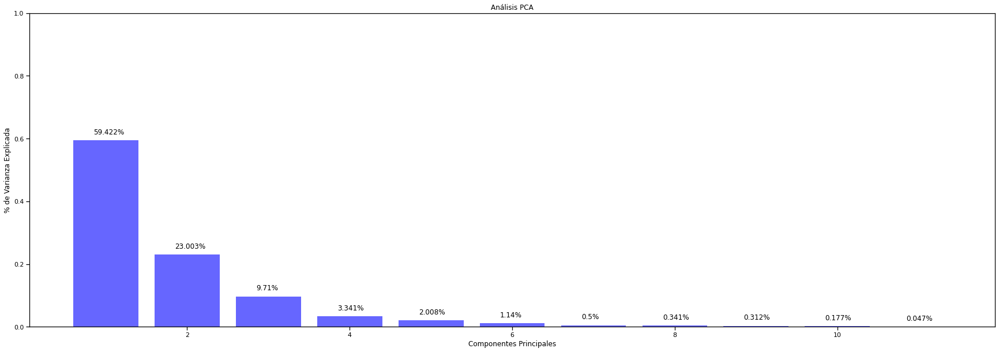

In [108]:
# Graficamos el resultado de PCA
n_var = X.shape[1] + 1
plt.figure(figsize= (30,10))
plt.ylabel('% de Varianza Explicada')
plt.xlabel('Componentes Principales')
plt.title('Análisis PCA')
plt.bar(range(1,n_var),variance, alpha=0.6, color= 'blue')
for a,b in zip(list(range(1,n_var)), variance): 
    plt.text(a-0.15,b+0.02, str((b*100).round(3)) + "%")

plt.ylim(0,1)

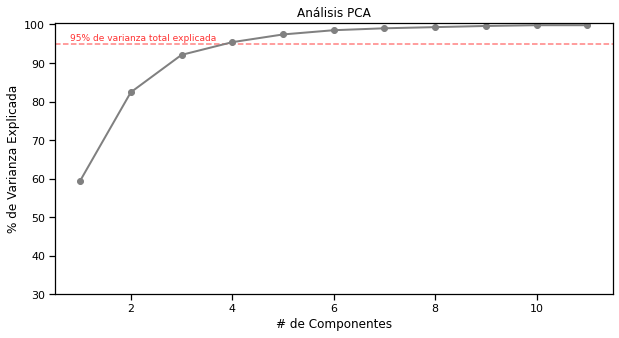

[59.4 82.4 92.1 95.4 97.4 98.5 99.  99.3 99.6 99.8 99.8]


In [109]:
# Graficamos el porcentaje de varianza explicada
plt.figure(figsize=(10,5))
plt.ylabel('% de Varianza Explicada')
plt.xlabel('# de Componentes')
plt.title('Análisis PCA')
plt.ylim(30,100.5)
plt.axhline(95, ls= '--', color = 'red', alpha = 0.5)
plt.text(0.8, 96, '95% de varianza total explicada', color = 'red', fontsize=9, alpha = 0.8)
plt.plot(range(1,n_var), explained_variance, marker='o', lw=2, color='grey')
plt.show()
print(explained_variance)

In [110]:
# Con el analisis PCA buscamos cuál es el número de componentes que nos ayudan a explicar el 95% de la varianaza.
# Por lo que según esta técnica podríamos considerar 4 a 6 grupos para el clustering

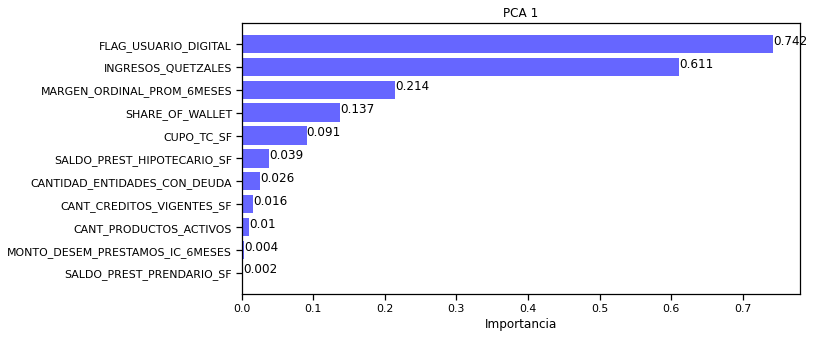

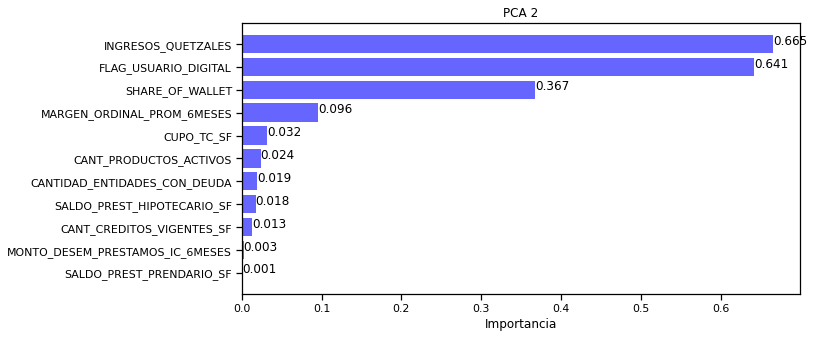

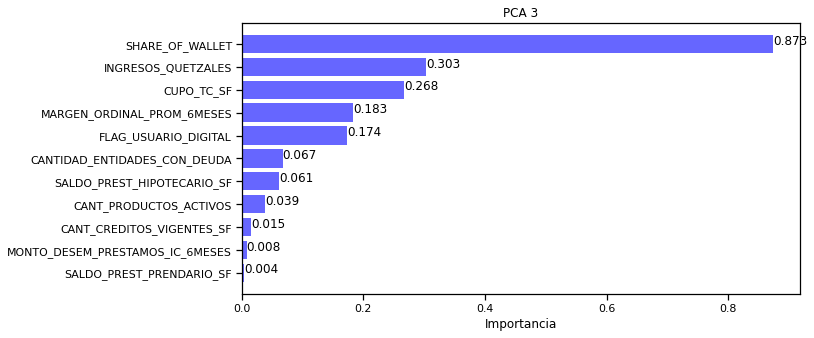

In [111]:
# La importancia de cada característica se refleja en la magnitud de los valores correspondientes en los vectores propios (a mayor magnitud, mayor importancia).
# Se muestra la grafica para las 3 componentes principales
importance_abs = abs(pca.components_)
for i_pca in range(importance_abs.shape[0]):
    n_importance = np.argsort(importance_abs[i_pca,:])
    importance_abs_ord = importance_abs[i_pca,:][n_importance]
    if i_pca<3:
        n_var = X.shape[1] + 1
        plt.figure(figsize= (10,5))
        plt.xlabel('Importancia')
        plt.title(f'PCA {i_pca+1}')
        plt.barh(range(1,n_var), importance_abs_ord, alpha=0.6, color= 'blue')
        plt.yticks(range(1,n_var), df_modelo.columns[n_importance])
        for a,b in zip(list(range(1,n_var)), importance_abs_ord): 
            plt.text(b, a, str((b).round(3)))

In [112]:
# Funcion para crear tabla de importancia para PCA
def pca_table_importance(importance_abs, var_names, order_by='PCA_1'):
    index_pca = [f'PCA_{i+1}' for i in range(importance_abs.shape[0])]
    return pd.DataFrame(importance_abs, columns=var_names, index=index_pca).T.sort_values(by=order_by, ascending=False)

In [113]:
# Creamos tabla donde se resume la importancia para el analisis de PCA, rdenadas por la primera componente 
df_pca_table = pca_table_importance(importance_abs, df_modelo.columns, order_by='PCA_1')
df_pca_table

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11
FLAG_USUARIO_DIGITAL,0.742,0.641,0.174,0.086,0.006,0.002,0.004,0.008,0.008,0.001,0.001
INGRESOS_QUETZALES,0.611,0.665,0.303,0.300,0.019,0.010,0.015,0.014,0.038,0.001,0.001
MARGEN_ORDINAL_PROM_6MESES,0.214,0.096,0.183,0.807,0.505,0.021,0.036,0.042,0.032,0.006,0.002
SHARE_OF_WALLET,0.137,0.367,0.873,0.216,0.153,0.058,0.008,0.059,0.080,0.008,0.004
CUPO_TC_SF,0.091,0.032,0.268,0.440,0.842,0.001,0.025,0.119,0.026,0.025,0.011
SALDO_PREST_HIPOTECARIO_SF,0.039,0.018,0.061,0.057,0.011,0.056,0.724,0.413,0.541,0.021,0.008
CANTIDAD_ENTIDADES_CON_DEUDA,0.026,0.019,0.067,0.079,0.102,0.131,0.142,0.662,0.693,0.134,0.059
CANT_CREDITOS_VIGENTES_SF,0.016,0.013,0.015,0.029,0.030,0.014,0.673,0.593,0.438,0.020,0.005
CANT_PRODUCTOS_ACTIVOS,0.010,0.024,0.039,0.014,0.009,0.985,0.012,0.068,0.140,0.048,0.023
MONTO_DESEM_PRESTAMOS_IC_6MESES,0.004,0.003,0.008,0.003,0.011,0.064,0.022,0.110,0.068,0.989,0.027


In [114]:
# Guadamos la tabla de importancias de PCA en Excel
# directory = '2. Output Excel'
# if not os.path.exists(directory):
#     os.makedirs(directory)

# file_name = 'modelo_20_pca.xlsx'
# df_pca_table.to_excel(f'{directory}/{file_name}')

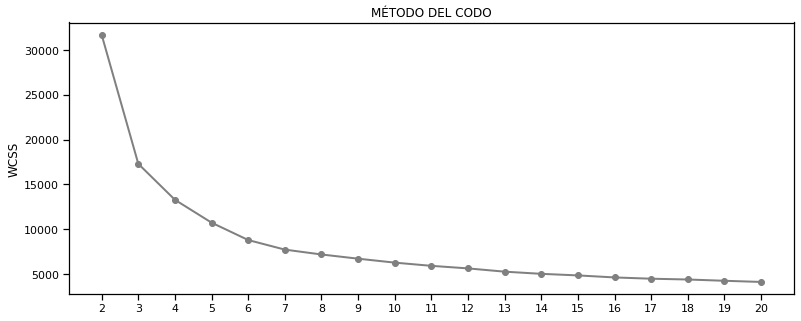

In [115]:
"""Gráfico del método del codo"""
plt.figure(figsize=(13,5)) #Tamaño de la figura
plt.title('MÉTODO DEL CODO') #Título
plt.ylabel('WCSS') #Título del eje Y
plt.xticks(range(2,21)) #Valores del eje X
#Ejecutar gráfico
plt.plot(range(2,21) ,inertias, marker='o', lw=2, color='grey')
plt.show()

In [116]:
# Con el metodo del codo buscamos un valor k en el que la varianza intra grupo deje de disminuir significativamente.
# Gráficamente vemos que ello se da con un k=4a 10

In [117]:
# Finalmente, de las 2 técnicas se escoge un rango de K, para realizar el análisis 
# El K sugerido entre las 3 técnicas es de 4 o 6

# Modelo Kmeans: K=6

In [118]:
# Probamos con un K=6
n_clusters = 6

km = KMeans(n_clusters= n_clusters, **kmeans_kwargs)
km.fit(X)
clusters = km.labels_
centroids = km.cluster_centers_

fig_scatter_2D = go.Figure(data=go.Scatter(x=principal_components.iloc[:, 0], y=principal_components.iloc[:, 1], marker_color=km.labels_, mode='markers'))
fig_scatter_2D.update_xaxes(title_text = 'PCA 1')
fig_scatter_2D.update_yaxes(title_text = 'PCA 2')
fig_scatter_2D.update_layout(width=800, height=600)
fig_scatter_2D.show()

In [119]:
# En esta gráfica podemos ver una representación compacta de los clusters seleccionados con kmeans.
print(f'Mediante el Análisis de 2 componentes principales que explican: {explained_variance[1]}% de la varianza')

Mediante el Análisis de 2 componentes principales que explican: 82.4% de la varianza


In [121]:
# En esta gráfica podemos ver una representación compacta de los clusters seleccionados con kmeans.
print(f'Mediante el Análisis de 3 componentes principales que explican: {explained_variance[2]}% de la varianza')

Mediante el Análisis de 3 componentes principales que explican: 92.10000000000001% de la varianza


K = 6 Average silhouette_score: 0.509845903595436


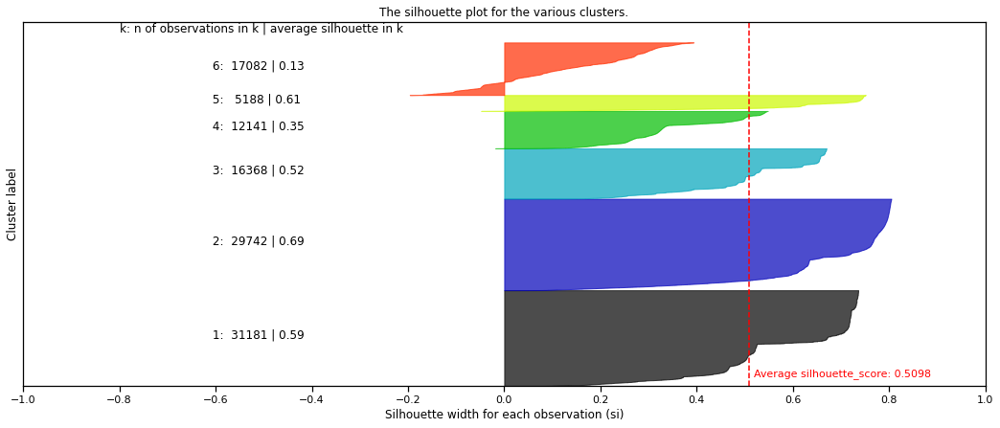

In [122]:
# Grafico para la silueta promedio
fig, ax1 = plt.subplots(1, 1)
fig.set_size_inches(18, 7)

ax1.set_xlim([-1, 1])
ax1.set_ylim([0, len(X)*1.06 + (n_clusters + 1) * 10])

clusterer = KMeans(n_clusters= n_clusters, **kmeans_kwargs)
cluster_labels = clusterer.fit_predict(X)

silhouette_avg = silhouette_score(X, cluster_labels)
print("K =", n_clusters, "Average silhouette_score:", silhouette_avg)

sample_silhouette_values = silhouette_samples(X, cluster_labels)

y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = \
        sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                        0, ith_cluster_silhouette_values,
                        facecolor=color, edgecolor=color, alpha=0.7)

    ax1.text(-0.8, y_lower + 0.5 * size_cluster_i, f'{i+1:26d}: {size_cluster_i:6d} | {ith_cluster_silhouette_values.sum()/size_cluster_i:4.2f}')
    y_lower = y_upper + 10

ax1.text(-0.8, len(X)*1.03 + (n_clusters + 1) * 10, 'k: n of observations in k | average silhouette in k')
ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("Silhouette width for each observation (si)")
ax1.set_ylabel("Cluster label")
ax1.text(silhouette_avg+0.01, len(X)*0.03, f'Average silhouette_score: {silhouette_avg:.4f}', color = 'red', fontsize=11)

ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])
ax1.set_xticks([-1.0, -0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])

plt.show()

In [123]:
# Cantidad de valores de silueta
sample_silhouette_values.shape[0]

111702

In [124]:
# Creamos una copia de la data con los valores de silueta positivos
X_pos = X.copy()

In [125]:
# Total de datos con silueta positivo
X_pos.shape[0]

111702

In [126]:
# Verificamos que el dataset contenga todas las variables incluso las que no se utilziaron para el clustering
df_sin_outliers.columns

Index(['IdCliente', 'SALDO_TOTAL_SF', 'SHARE_OF_WALLET',
       'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEMB_TOTAL_SF_ULT6M',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'SALDO_PREST_FIDUCIARIO_SF', 'SHARE_OF_WALLET_FIDUCIARIO',
       'SALDO_PREST_FIDUC_COMPETIDORES', 'CANT_DESEMBOLSOS_IC_6MESES',
       'MONTO_DESEM_PRESTAMOS_IC_6MESES', 'CANT_DESEMB_IC_6MESES',
       'SALDO_SUM_IC_6MESES', 'SALDO_PROM_IC_6MESES',
       'MARGEN_ORDINAL_PROM_6MESES', 'CANT_TIPO_PRODUCTOS_ACTIVOS',
       'CANT_PRODUCTOS_ACTIVOS', 'TIEMPO_LABORANDO_MESES', 'EDAD_ANIOS',
       'INGRESOS_QUETZALES', 'ANTIGUEDAD_IC_CORTE', 'FLAG_USUARIO_DIGITAL'],
      dtype='object')

In [127]:
# Creamos copia de la data sin escalar con los valores de silueta positivos
df_sin_outliers_pos = df_sin_outliers[['IdCliente','ANTIGUEDAD_IC_CORTE','TIEMPO_LABORANDO_MESES','SALDO_TOTAL_SF','SALDO_PREST_FIDUCIARIO_SF','EDAD_ANIOS'] + variables_modelo].copy()
df_sin_outliers_pos.head()

,IdCliente,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL
0,10000,"4,306.000",108.000,"71,825.812","29,134.410",36.000,0.000,3,"59,244.309",2.000,0.000,0.000,0.000,0.000,0.000,"7,000.000",0
8,100000,289.000,7.000,"9,888.480","9,888.480",22.000,0.000,2,"3,200.000",2.000,0.000,0.000,0.000,7.801,0.000,"3,450.500",0
12,100002,285.000,24.000,"3,749.990","3,749.990",25.000,1.000,1,0.000,2.000,0.000,0.000,0.000,20.155,1.000,"6,000.000",1
20,100004,289.000,6.000,"10,464.730","10,464.730",23.000,1.000,1,0.000,2.000,0.000,0.000,0.000,118.582,1.000,"3,100.000",1
25,100005,288.000,84.000,"6,804.000","6,804.000",51.000,1.000,1,0.000,2.000,0.000,0.000,0.000,91.276,1.000,"3,209.000",1


In [128]:
# Comprobamos la cantidad de valores antes y después del retiro de silueta negativa
print(f'Cantidad de datos inicial: {df_sin_outliers.shape[0]}\nCantidad de datos despues del retiro: {df_sin_outliers_pos.shape[0]}')

Cantidad de datos inicial: 111702
Cantidad de datos despues del retiro: 111702


In [129]:
# Verificamos el porcentaje de data eliminada por ser negativa
print(f'Porcentaje de data eliminada por ser negativa: {(X.shape[0] - X_pos.shape[0])/X.shape[0]*100:.2f}%')

Porcentaje de data eliminada por ser negativa: 0.00%


In [130]:
# Agregamos la columna CLUSTER al dataframe para el analisis
df_sin_outliers_pos['CLUSTER'] = cluster_labels + 1
df_sin_outliers_pos.head()

,IdCliente,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER
0,10000,"4,306.000",108.000,"71,825.812","29,134.410",36.000,0.000,3,"59,244.309",2.000,0.000,0.000,0.000,0.000,0.000,"7,000.000",0,4
8,100000,289.000,7.000,"9,888.480","9,888.480",22.000,0.000,2,"3,200.000",2.000,0.000,0.000,0.000,7.801,0.000,"3,450.500",0,1
12,100002,285.000,24.000,"3,749.990","3,749.990",25.000,1.000,1,0.000,2.000,0.000,0.000,0.000,20.155,1.000,"6,000.000",1,2
20,100004,289.000,6.000,"10,464.730","10,464.730",23.000,1.000,1,0.000,2.000,0.000,0.000,0.000,118.582,1.000,"3,100.000",1,2
25,100005,288.000,84.000,"6,804.000","6,804.000",51.000,1.000,1,0.000,2.000,0.000,0.000,0.000,91.276,1.000,"3,209.000",1,2


In [131]:
# Verificamos cantidad de datos en los clusters
df_sin_outliers_pos[['IdCliente', 'CLUSTER']].groupby('CLUSTER').count()

,IdCliente
CLUSTER,
1,31181
2,29742
3,16368
4,12141
5,5188
6,17082


In [132]:
# Guardamos la data con la columna de CLUSTER
df_sin_outliers_pos.to_csv(ruta_output_k6, index=False)

In [133]:
# Funcion para guardar el box plot de cada variable numerica
def save_box_plot_cluster(df, list_vars, directory):
    fig = plt.figure(figsize =(15, 10))
    fig.patch.set_facecolor('#FFFFFF')
    sns.set_context("notebook")

    # Guarda las imagenes de box plot
    num_names = len(list_vars)
    for i in range(num_names):
        if not os.path.exists(directory):
            os.makedirs(directory)
        sns_plot = sns.boxplot(y=df[list_vars[i]], x = df['CLUSTER'])
        sns_plot.xaxis.labelpad = 20
        sns_plot.figure.savefig(f'{directory}\\{i+1}_{list_vars[i]}.png')
        plt.clf()

In [134]:
# Convertimos la variable CLUSTER a str para fines de visualización
df_sin_outliers_pos['CLUSTER'] =df_sin_outliers_pos['CLUSTER'].astype(int)

In [135]:
# Visuaizamos los primeros registros
df_sin_outliers_pos.head()

,IdCliente,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER
0,10000,"4,306.000",108.000,"71,825.812","29,134.410",36.000,0.000,3,"59,244.309",2.000,0.000,0.000,0.000,0.000,0.000,"7,000.000",0,4
8,100000,289.000,7.000,"9,888.480","9,888.480",22.000,0.000,2,"3,200.000",2.000,0.000,0.000,0.000,7.801,0.000,"3,450.500",0,1
12,100002,285.000,24.000,"3,749.990","3,749.990",25.000,1.000,1,0.000,2.000,0.000,0.000,0.000,20.155,1.000,"6,000.000",1,2
20,100004,289.000,6.000,"10,464.730","10,464.730",23.000,1.000,1,0.000,2.000,0.000,0.000,0.000,118.582,1.000,"3,100.000",1,2
25,100005,288.000,84.000,"6,804.000","6,804.000",51.000,1.000,1,0.000,2.000,0.000,0.000,0.000,91.276,1.000,"3,209.000",1,2


In [136]:
# Creamos funcion para describir los valores incluyendo nulos y ceros
def describe_nan(df, list_names=None, types='ALL'):
    if list_names==None:
        if types=='ALL':
            df_temp = df.copy()
        if types=='NUM':
            df_temp = df.select_dtypes(include=[np.number]).copy()
        if types=='OBJ':
            df_temp = df.select_dtypes(include=[object]).copy()
    else:
        df_temp = df[list_names].copy()
    count_nan = df_temp.isnull().sum(axis=0)
    total_row = df_temp.apply(lambda x: len(x))
    nan_porcen = (df_temp.apply(lambda x: x.isnull().sum(axis=0))/total_row*100).round(0).astype(str)
    count_ceros = df_temp[df_temp==0].count(axis=0)
    ceros_porcen = (df_temp.apply(lambda x: x[x==0].count())/total_row*100).round(0).astype(str)
    df_describe = df_temp.describe().append(pd.Series(count_nan, name='Count_NaN'))
    df_describe = df_describe.append(pd.Series(nan_porcen, name='Porcen_NaN'))
    df_describe = df_describe.append(pd.Series(count_ceros, name='Count_Ceros'))
    df_describe = df_describe.append(pd.Series(ceros_porcen, name='Porcen_Ceros'))
    df_describe = df_describe.append(pd.Series(total_row, name='Total_Row'))
    return df_describe

In [137]:
df_sin_outliers_pos.median()

IdCliente                         133,232.000
ANTIGUEDAD_IC_CORTE                 1,362.000
TIEMPO_LABORANDO_MESES                 60.000
SALDO_TOTAL_SF                     11,341.564
SALDO_PREST_FIDUCIARIO_SF           6,920.010
EDAD_ANIOS                             32.000
SHARE_OF_WALLET                         0.000
CANTIDAD_ENTIDADES_CON_DEUDA            1.000
CUPO_TC_SF                          3,000.000
CANT_CREDITOS_VIGENTES_SF               2.000
MONTO_DESEM_PRESTAMOS_IC_6MESES         0.000
SALDO_PREST_PRENDARIO_SF                0.000
SALDO_PREST_HIPOTECARIO_SF              0.000
MARGEN_ORDINAL_PROM_6MESES              0.000
CANT_PRODUCTOS_ACTIVOS                  0.000
INGRESOS_QUETZALES                  3,938.000
FLAG_USUARIO_DIGITAL                    1.000
CLUSTER                                 2.000
dtype: float64

In [138]:
# Calculamos los estadísticos por cluster y variable
lista_descriptivos = []
for cluster in  df_sin_outliers_pos.CLUSTER.unique():
    df_tmp = df_sin_outliers_pos[df_sin_outliers_pos.CLUSTER == cluster]
    medianas = df_tmp.median()
    df_describe = df_tmp.describe().append(pd.Series(medianas, name='medianas'))
    
#     file_name = ruta_descriptivos.format(cluster)
    df_describe.index = '{}_'.format(cluster) + df_describe.index.astype(str)
    lista_descriptivos.append(df_describe)
    print(cluster)
    display(df_describe)
df_describe_final = pd.concat(lista_descriptivos)
    
df_describe_final.to_excel(ruta_descriptivos_k6)
    

4


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
4_count,"12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000","12,141.000",NaN
4_mean,"2,958.138",116.939,"97,952.461","46,843.238",38.225,0.024,3.543,"52,807.617",1.603,42.109,"3,601.208","17,977.186",8.139,0.091,"5,494.063",0.000,4.000,NaN
4_std,"1,878.506",88.442,"157,383.328","75,538.906",10.114,0.079,0.710,"76,355.500",1.383,622.599,"22,023.617","111,423.805",26.718,0.297,"4,030.717",0.000,0.000,NaN
4_min,0.000,1.000,0.000,0.000,19.000,0.000,2.000,0.000,0.000,0.000,0.000,0.000,-31.138,0.000,"1,000.000",0.000,4.000,NaN
4_25%,"1,640.000",48.000,"23,359.070",0.000,30.000,0.000,3.000,"11,800.000",1.000,0.000,0.000,0.000,0.000,0.000,"3,300.000",0.000,4.000,NaN
4_50%,"2,438.000",96.000,"50,986.859","20,401.010",37.000,0.000,3.000,"26,136.000",1.000,0.000,0.000,0.000,0.000,0.000,"4,250.000",0.000,4.000,NaN
4_75%,"4,182.000",170.000,"112,347.031","58,056.219",45.000,0.000,4.000,"57,995.602",2.000,0.000,0.000,0.000,0.000,0.000,"6,000.000",0.000,4.000,NaN
4_max,"8,914.000",600.000,"4,027,721.500","1,404,862.250",66.000,0.920,5.000,"651,210.750",10.000,"26,250.000","336,932.719","2,959,765.750",500.000,3.000,"40,000.000",0.000,4.000,NaN
4_medianas,"2,438.000",96.000,"50,986.859","20,401.010",37.000,0.000,3.000,"26,136.000",1.000,0.000,0.000,0.000,0.000,0.000,"4,250.000",0.000,4.000,"204,676.000"


1


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
1_count,"31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000","31,181.000",NaN
1_mean,"2,598.830",110.303,"38,728.766","24,514.773",37.897,0.008,1.417,"11,113.619",0.922,8.432,"1,186.280","7,241.223",2.989,0.040,"4,650.054",0.000,1.000,NaN
1_std,"1,755.606",90.360,"80,074.391","47,995.293",10.573,0.047,0.493,"25,073.334",0.963,242.718,"12,238.960","59,284.410",15.468,0.199,"3,080.344",0.000,0.000,NaN
1_min,0.000,1.000,0.000,0.000,18.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,-45.257,0.000,"1,000.000",0.000,1.000,NaN
1_25%,"1,389.000",36.000,"4,058.060",0.000,29.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,"3,000.000",0.000,1.000,NaN
1_50%,"2,041.000",85.000,"13,750.000","5,532.440",36.000,0.000,1.000,"4,200.000",1.000,0.000,0.000,0.000,0.000,0.000,"3,800.000",0.000,1.000,NaN
1_75%,"3,396.000",161.000,"40,621.102","26,757.029",45.000,0.000,2.000,"11,595.870",1.000,0.000,0.000,0.000,0.000,0.000,"5,000.000",0.000,1.000,NaN
1_max,"8,950.000",600.000,"3,213,681.250","1,229,583.250",69.000,0.518,2.000,"604,999.938",10.000,"14,700.000","308,660.750","2,437,146.750",500.000,3.000,"40,000.000",0.000,1.000,NaN
1_medianas,"2,041.000",85.000,"13,750.000","5,532.440",36.000,0.000,1.000,"4,200.000",1.000,0.000,0.000,0.000,0.000,0.000,"3,800.000",0.000,1.000,"213,296.000"


2


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
2_count,"29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000","29,742.000",NaN
2_mean,809.309,58.671,"6,627.879","6,395.047",31.000,0.971,1.151,583.504,2.265,724.386,0.193,0.000,41.153,0.932,"4,277.439",1.000,2.000,NaN
2_std,940.520,64.255,"6,015.677","5,691.129",9.811,0.090,0.387,"2,913.546",1.117,"2,409.705",17.888,0.000,46.383,0.467,"2,643.616",0.000,0.000,NaN
2_min,0.000,1.000,0.030,0.000,18.000,0.464,1.000,0.000,0.000,0.000,0.000,0.000,-186.384,0.000,"1,000.000",1.000,2.000,NaN
2_25%,255.000,15.000,"2,006.550","1,999.000",23.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,9.942,1.000,"3,084.292",1.000,2.000,NaN
2_50%,418.000,36.000,"4,657.845","4,545.665",28.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,31.011,1.000,"3,500.000",1.000,2.000,NaN
2_75%,"1,158.000",72.000,"9,949.412","9,641.485",36.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,70.302,1.000,"4,500.000",1.000,2.000,NaN
2_max,"8,863.000",586.000,"83,963.938","83,963.938",66.000,1.000,4.000,"148,800.000",10.000,"30,000.000","2,055.330",0.000,500.000,3.000,"40,000.000",1.000,2.000,NaN
2_medianas,418.000,36.000,"4,657.845","4,545.665",28.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,31.011,1.000,"3,500.000",1.000,2.000,"91,291.500"


6


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
6_count,"17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000","17,082.000",NaN
6_mean,"1,447.223",70.752,"46,926.016","30,328.854",32.823,0.160,3.068,"14,629.899",2.819,254.702,"1,043.111","3,511.109",33.347,0.620,"5,320.674",1.000,6.000,NaN
6_std,"1,210.054",65.766,"73,434.078","43,936.672",9.287,0.179,0.897,"24,200.199",1.633,"1,431.404","12,098.883","44,656.844",43.856,0.589,"3,782.488",0.000,0.000,NaN
6_min,0.000,1.000,0.000,0.000,18.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,-115.319,0.000,"1,000.000",1.000,6.000,NaN
6_25%,521.000,24.000,"13,572.975","6,361.412",26.000,0.000,2.000,"2,800.000",2.000,0.000,0.000,0.000,0.000,0.000,"3,500.000",1.000,6.000,NaN
6_50%,"1,220.000",48.000,"26,780.670","16,564.301",30.000,0.091,3.000,"7,600.000",3.000,0.000,0.000,0.000,20.126,1.000,"4,250.000",1.000,6.000,NaN
6_75%,"1,962.000",96.000,"53,623.197","35,955.683",38.000,0.279,4.000,"17,640.583",4.000,0.000,0.000,0.000,49.135,1.000,"6,000.000",1.000,6.000,NaN
6_max,"8,690.000",576.000,"3,331,318.000","1,050,000.000",70.000,0.840,5.000,"559,316.438",10.000,"30,000.000","345,787.906","3,108,171.250",500.000,3.000,"40,000.000",1.000,6.000,NaN
6_medianas,"1,220.000",48.000,"26,780.670","16,564.301",30.000,0.091,3.000,"7,600.000",3.000,0.000,0.000,0.000,20.126,1.000,"4,250.000",1.000,6.000,"78,371.000"


3


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
3_count,"16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000","16,368.000",NaN
3_mean,"1,407.316",66.993,"24,733.312","17,460.320",32.198,0.015,1.437,"6,081.663",1.108,11.665,557.842,"2,337.557",9.937,0.232,"4,656.170",1.000,3.000,NaN
3_std,"1,189.389",67.526,"44,723.355","34,326.848",9.201,0.055,0.496,"10,688.259",0.952,266.712,"8,466.836","25,104.404",27.588,0.435,"2,865.363",0.000,0.000,NaN
3_min,0.000,1.000,0.000,0.000,18.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,-111.848,0.000,"1,500.000",1.000,3.000,NaN
3_25%,535.000,24.000,"2,776.270",0.000,26.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,"3,200.000",1.000,3.000,NaN
3_50%,"1,205.000",48.000,"9,562.085","3,537.075",30.000,0.000,1.000,"3,200.000",1.000,0.000,0.000,0.000,0.000,0.000,"4,000.000",1.000,3.000,NaN
3_75%,"1,852.000",84.000,"27,576.630","19,468.552",37.000,0.000,2.000,"7,245.555",2.000,0.000,0.000,0.000,9.794,0.000,"5,000.000",1.000,3.000,NaN
3_max,"8,885.000",606.000,"913,094.125","522,781.688",66.000,0.507,2.000,"184,000.000",10.000,"19,000.000","344,129.781","891,587.312",500.000,2.000,"40,000.000",1.000,3.000,NaN
3_medianas,"1,205.000",48.000,"9,562.085","3,537.075",30.000,0.000,1.000,"3,200.000",1.000,0.000,0.000,0.000,0.000,0.000,"4,000.000",1.000,3.000,"165,245.000"


5


,ANTIGUEDAD_IC_CORTE,TIEMPO_LABORANDO_MESES,SALDO_TOTAL_SF,SALDO_PREST_FIDUCIARIO_SF,EDAD_ANIOS,SHARE_OF_WALLET,CANTIDAD_ENTIDADES_CON_DEUDA,CUPO_TC_SF,CANT_CREDITOS_VIGENTES_SF,MONTO_DESEM_PRESTAMOS_IC_6MESES,SALDO_PREST_PRENDARIO_SF,SALDO_PREST_HIPOTECARIO_SF,MARGEN_ORDINAL_PROM_6MESES,CANT_PRODUCTOS_ACTIVOS,INGRESOS_QUETZALES,FLAG_USUARIO_DIGITAL,CLUSTER,IdCliente
5_count,"5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000","5,188.000",NaN
5_mean,"1,249.698",72.610,"7,664.236","7,238.960",35.459,0.928,1.290,978.632,1.913,544.326,3.118,0.000,52.747,0.824,"4,152.060",0.000,5.000,NaN
5_std,"1,160.620",72.395,"7,318.979","6,884.451",11.165,0.153,0.534,"3,455.286",1.144,"2,219.486",215.401,0.000,45.171,0.459,"2,297.136",0.000,0.000,NaN
5_min,0.000,1.000,0.060,0.000,19.000,0.324,1.000,0.000,0.000,0.000,0.000,0.000,-73.086,0.000,"1,300.000",0.000,5.000,NaN
5_25%,498.000,24.000,"2,795.965","2,683.930",26.000,1.000,1.000,0.000,1.000,0.000,0.000,0.000,20.956,1.000,"3,000.000",0.000,5.000,NaN
5_50%,834.000,48.000,"5,806.300","5,487.380",33.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,44.822,1.000,"3,500.000",0.000,5.000,NaN
5_75%,"1,656.250",96.000,"10,129.683","9,674.778",43.000,1.000,2.000,0.000,2.000,0.000,0.000,0.000,73.867,1.000,"4,500.000",0.000,5.000,NaN
5_max,"8,677.000",600.000,"87,354.133","87,354.133",65.000,1.000,4.000,"78,800.000",10.000,"30,000.000","15,500.000",0.000,500.000,3.000,"40,000.000",0.000,5.000,NaN
5_medianas,834.000,48.000,"5,806.300","5,487.380",33.000,1.000,1.000,0.000,2.000,0.000,0.000,0.000,44.822,1.000,"3,500.000",0.000,5.000,"87,160.500"


In [139]:
# Listamos las columnas a plotear
cols_plot = ['ANTIGUEDAD_IC_CORTE', 'TIEMPO_LABORANDO_MESES',
       'SALDO_TOTAL_SF', 'SALDO_PREST_FIDUCIARIO_SF', 'EDAD_ANIOS',
       'SHARE_OF_WALLET', 'CANTIDAD_ENTIDADES_CON_DEUDA', 'CUPO_TC_SF',
       'CANT_CREDITOS_VIGENTES_SF', 'MONTO_DESEM_PRESTAMOS_IC_6MESES',
       'SALDO_PREST_PRENDARIO_SF', 'SALDO_PREST_HIPOTECARIO_SF',
       'MARGEN_ORDINAL_PROM_6MESES', 'CANT_PRODUCTOS_ACTIVOS',
       'INGRESOS_QUETZALES', 'FLAG_USUARIO_DIGITAL']

In [140]:
# Ordenamos la data por CLUSTER
df_sin_outliers_pos.sort_values('CLUSTER', ascending=True, inplace = True)

In [142]:
# Obtenemos colores por cluster
cluster_colors = [
]
for i in range(n_clusters) :
    color =  cm.nipy_spectral(float(i) / n_clusters)
    cluster_colors.append(color)


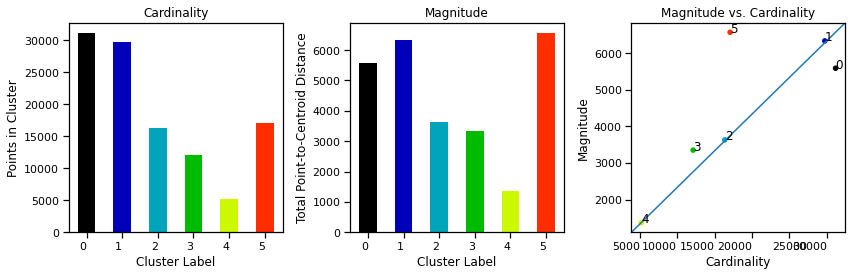

In [143]:
# Visualizamos la cardinalidad y la magnitud

fig, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(12,4))

plot_cluster_cardinality(cluster_labels,
                         ax=ax1,
                         title="Cardinality",
                         color=cluster_colors
                        )
plot_cluster_magnitude(X,
                       cluster_labels,
                       clusterer.cluster_centers_,
                       euclidean,
                       ax=ax2,
                       title="Magnitude",
                       color=cluster_colors
                      )
plot_magnitude_vs_cardinality(X,
                             cluster_labels,
                              clusterer.cluster_centers_,
                              euclidean,
                              color=cluster_colors[0:n_clusters],
                              ax=ax3, 
                              title="Magnitude vs. Cardinality")

fig.autofmt_xdate(rotation=0)
plt.tight_layout()
plt.show()

In [144]:
X_mean = pd.concat([pd.DataFrame(df_sin_outliers_pos[cols_plot].mean(), columns=['mean']), 
                   df_sin_outliers_pos[['CLUSTER']+cols_plot].groupby('CLUSTER').mean().T], axis=1)

X_dev_rel = X_mean.apply(lambda x: round((x-x['mean'])/x['mean'],2)*100, axis = 1)
X_dev_rel.drop(columns=['mean'], inplace=True)
X_mean.drop(columns=['mean'], inplace=True)

X_std_mean = pd.concat([pd.DataFrame(df_sin_outliers_pos[cols_plot].mean(), columns=['mean']), 
                   df_sin_outliers_pos[['CLUSTER']+cols_plot].groupby('CLUSTER').mean().T], axis=1)

X_std_dev_rel = X_std_mean.apply(lambda x: round((x-x['mean'])/x['mean'],2)*100, axis = 1)
X_std_dev_rel.drop(columns=['mean'], inplace=True)
X_std_mean.drop(columns=['mean'], inplace=True)

In [145]:
X_std_mean

,1,2,3,4,5,6
ANTIGUEDAD_IC_CORTE,"2,598.830",809.307,"1,407.306","2,958.132","1,249.698","1,447.221"
TIEMPO_LABORANDO_MESES,110.303,58.671,66.993,116.939,72.610,70.752
SALDO_TOTAL_SF,"38,728.766","6,627.881","24,733.264","97,952.484","7,664.241","46,925.941"
SALDO_PREST_FIDUCIARIO_SF,"24,514.836","6,395.040","17,460.350","46,843.207","7,238.960","30,328.742"
EDAD_ANIOS,37.897,31.000,32.198,38.225,35.459,32.823
SHARE_OF_WALLET,0.008,0.971,0.015,0.024,0.928,0.160
CANTIDAD_ENTIDADES_CON_DEUDA,1.417,1.151,1.437,3.543,1.290,3.068
CUPO_TC_SF,"11,113.606",583.505,"6,081.671","52,807.707",978.632,"14,629.899"
CANT_CREDITOS_VIGENTES_SF,0.922,2.265,1.108,1.603,1.913,2.819
MONTO_DESEM_PRESTAMOS_IC_6MESES,8.432,724.386,11.665,42.109,544.326,254.702


In [146]:
X_std_mean.T.iloc[0].values

array([2.59882983e+03, 1.10303200e+02, 3.87287656e+04, 2.45148359e+04,
       3.78967628e+01, 8.41564126e-03, 1.41672814e+00, 1.11136064e+04,
       9.22067940e-01, 8.43160899e+00, 1.18628027e+03, 7.24122314e+03,
       2.98908552e+00, 3.96074541e-02, 4.65005446e+03, 0.00000000e+00])

In [147]:
cluster_colors = ['purple','red','green','pink', 'orange','skyblue']